# Visualization

The idea of this notebook is to visualize each column in order to try to understand and try to detect any problem with the data

Summary of main important conclusions:

* 21613 rows
* 20 features (including the label `price`)
* There are several duplicate IDs in the data. The only thing that differs between them is the `date` and the price. My conclusion is that this means this dataset probably represents house sales, not house ads.
* There are no nulls/NaN.
* There seems to be no relation between `price` and `date`. Of course data drift is a concern in this type of problem but the window of this dataset in particular is not big enough, so I will discard that concern for this project.
* Columns that are apparently categorical such as `grade` and `view`, have their order highly correlated with `price`, so there's no point in encoding them.
* `yr_built` - The values range from 1900 to 2015. It will make it simpler if we use it to compute a `construction_age` feature.
* `yr_renovate` - Non renovated houses are imputed with 0. My approach here will be to convert it into a `renovation_age` feature and pad it to a max value of `construction_age`.
* `zip_code` - Zip code can be treated either as numerical or categorical. 
    * Close zip codes appear to have similar pricing, which can be better captured with the feature as numerical
    * There are however some "fancy" zip codes which are price outliers. This is more likely to be captured as a categorical feature

In [1]:
import pandas as pd
import numpy as np
import time
import datetime
import plotly.express as px
import plotly.graph_objects as go

pd.options.plotting.backend = "plotly"

In [2]:
from pyspark.sql import SparkSession

spark = (
    SparkSession.builder.getOrCreate()
)

2022-12-26 17:31:33,156 WARN util.Utils: Your hostname, laptop-2212 resolves to a loopback address: 127.0.1.1; using 192.168.50.118 instead (on interface wlp3s0)
2022-12-26 17:31:33,157 WARN util.Utils: Set SPARK_LOCAL_IP if you need to bind to another address
2022-12-26 17:31:33,927 WARN util.NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


In [3]:
from pyspark.sql.types import *

df = spark.read.csv("data/kc_house_data.csv", header=True, inferSchema=True)

# Checking duplicate IDS
The only thing that differs between them is the `date` and the price.

In [4]:
from pyspark.sql.functions import col


df.groupby("id").count().filter(col("count") > 1).join(df, "id").toPandas()

,id,count,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,6021501535,2,20140725T000000,430000.0,3,1.50,1580,5000,1.0,0,...,8,1290,290,1939,0,98117,47.6870,-122.386,1570,4500
1,6021501535,2,20141223T000000,700000.0,3,1.50,1580,5000,1.0,0,...,8,1290,290,1939,0,98117,47.6870,-122.386,1570,4500
2,4139480200,2,20140618T000000,1384000.0,4,3.25,4290,12103,1.0,0,...,11,2690,1600,1997,0,98006,47.5503,-122.102,3860,11244
3,4139480200,2,20141209T000000,1400000.0,4,3.25,4290,12103,1.0,0,...,11,2690,1600,1997,0,98006,47.5503,-122.102,3860,11244
4,7520000520,2,20140905T000000,232000.0,2,1.00,1240,12092,1.0,0,...,6,960,280,1922,1984,98146,47.4957,-122.352,1820,7460
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
348,8564860270,2,20150330T000000,502000.0,4,2.50,2680,5539,2.0,0,...,8,2680,0,2013,0,98045,47.4759,-121.734,2680,5992
349,6300000226,2,20140626T000000,240000.0,4,1.00,1200,2171,1.5,0,...,7,1200,0,1933,0,98133,47.7076,-122.342,1130,1598
350,6300000226,2,20150504T000000,380000.0,4,1.00,1200,2171,1.5,0,...,7,1200,0,1933,0,98133,47.7076,-122.342,1130,1598
351,7853420110,2,20141003T000000,594866.0,3,3.00,2780,6000,2.0,0,...,9,2780,0,2013,0,98065,47.5184,-121.886,2850,6000


*Converting the dataframe to Pandas so that's easier to analyze with plotly

In [5]:
df = df.toPandas()

* Converting the date string to timestamp to become visualizable

In [6]:
df["date"] = df["date"].map(lambda data_str: datetime.datetime.strptime(data_str, "%Y%m%dT%H%M%S"))
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


# Price

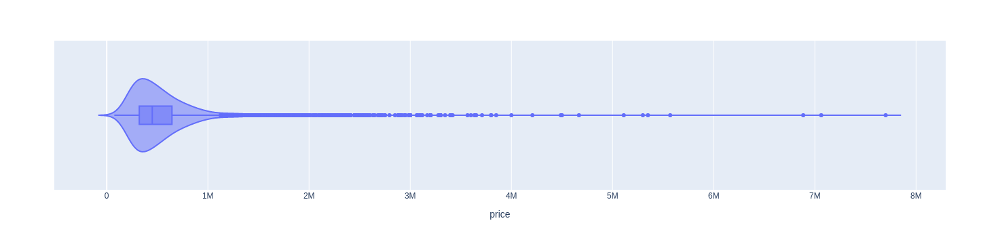

In [7]:
fig = px.violin(df, x="price", box=True)
fig.show()

# Histograms
* I'm not using violin plots for these one because histograms are better to observe data with discrete values (even though that's not the case of all features.
* In cases where huge discrepancies in the values distort the plot, I use logs scales.

In [8]:
def plot_hist(df, col, log_of_count, log_of_price, log_of_x_axis=False):
    fig = px.histogram(df, x=col, log_x=log_of_x_axis, log_y=log_of_count)
    fig.show()
    fig = px.histogram(df, x=col, y="price", log_x=log_of_x_axis, log_y=log_of_price, histfunc="avg", color_discrete_sequence=["green"])
    fig.show()

## Date

* There's clearly no correlation between the `date` and the prices

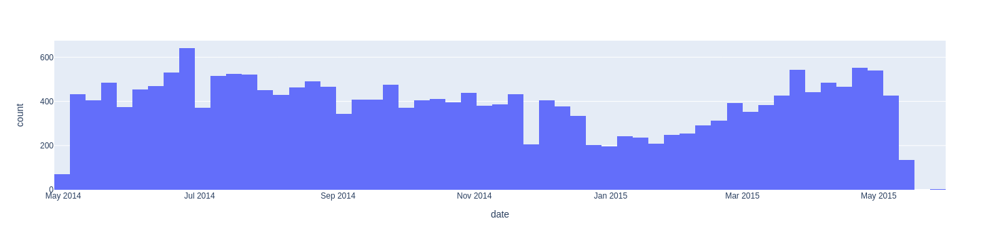

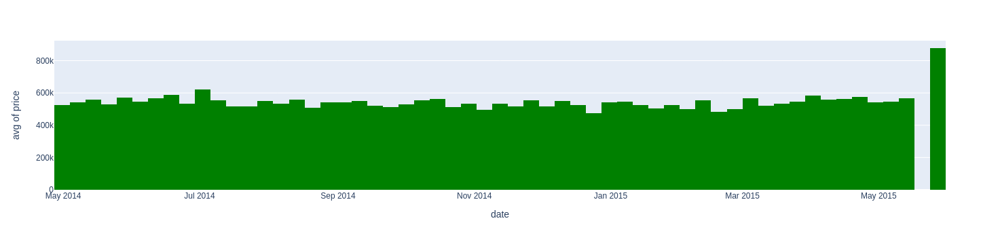

In [9]:
plot_hist(df, "date", log_of_count=False, log_of_price=False)

## Bedrooms

* There's a clear correlation between number of bedrooms and price. The prices seem to start to go down above 8 bedrooms, but that might also be because the number of rooms are magnitudes lower

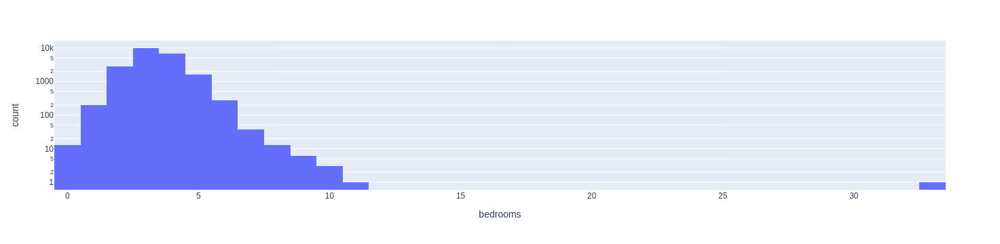

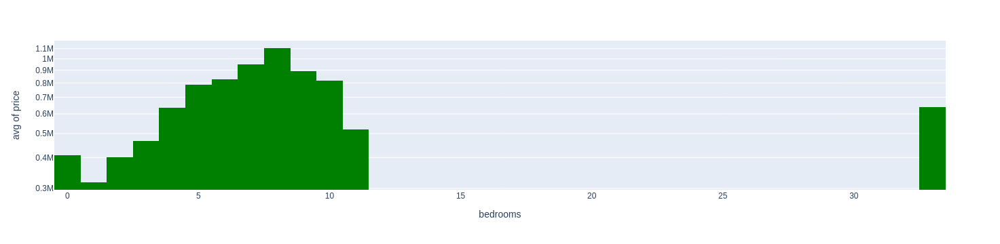

In [10]:
plot_hist(df, "bedrooms", log_of_count=True, log_of_price=True)

## Bathrooms

* There's something odd with the values of bathrooms. Instead of being integers, there are many rows with decimal values (more than half)
* Still, they are highly correlated with the price, and I don't see any reason to not usem like as they are.

In [11]:
# `True`'s are decimal value
df["bathrooms"].map(lambda x: int(x) == x).value_counts()

False    14903
True      6710
Name: bathrooms, dtype: int64

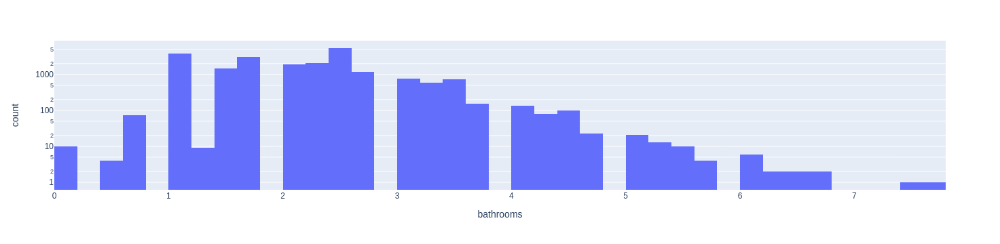

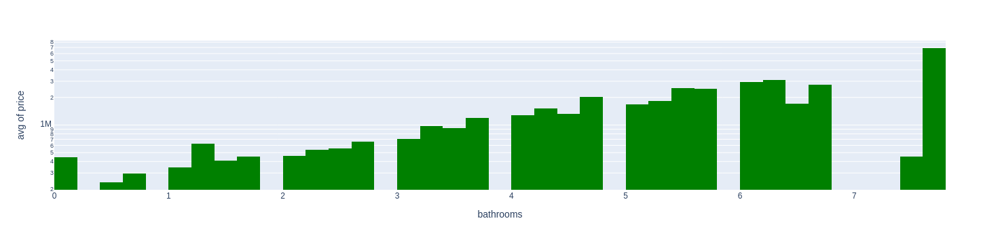

In [12]:
plot_hist(df, "bathrooms", log_of_count=True, log_of_price=True)

## Floors

* Floor, like bathrooms, has decimal values

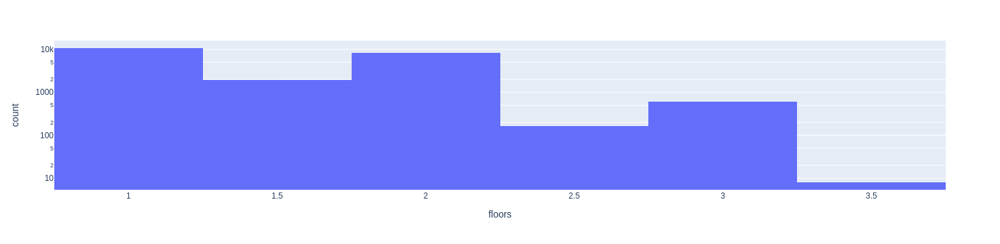

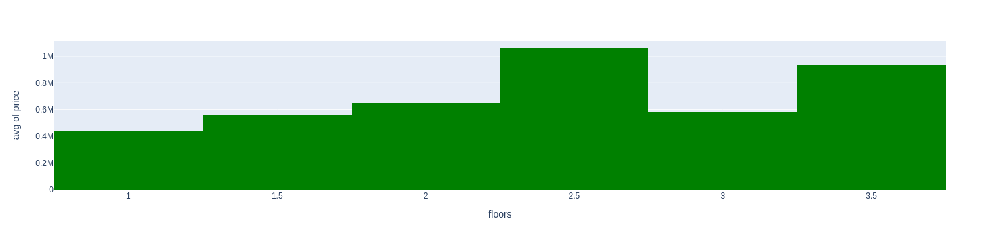

In [13]:
plot_hist(df, "floors", log_of_count=True, log_of_price=False)

## Waterfront

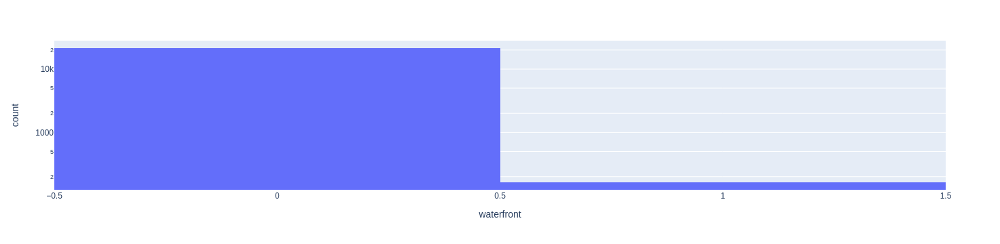

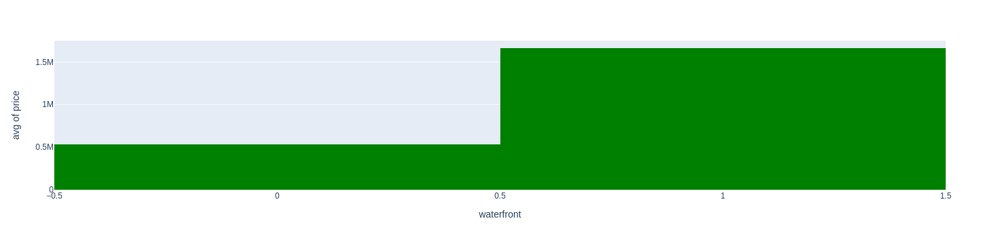

In [14]:
plot_hist(df, "waterfront", log_of_count=True, log_of_price=False)

## View

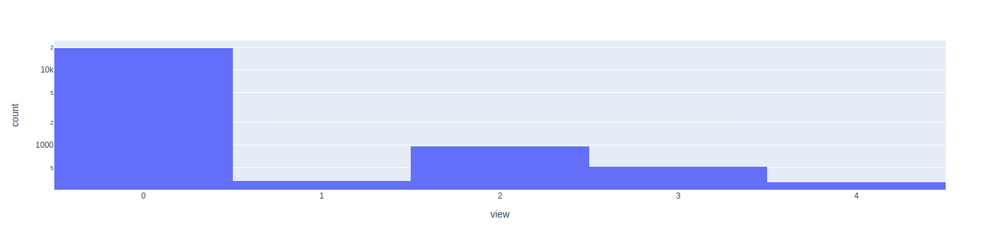

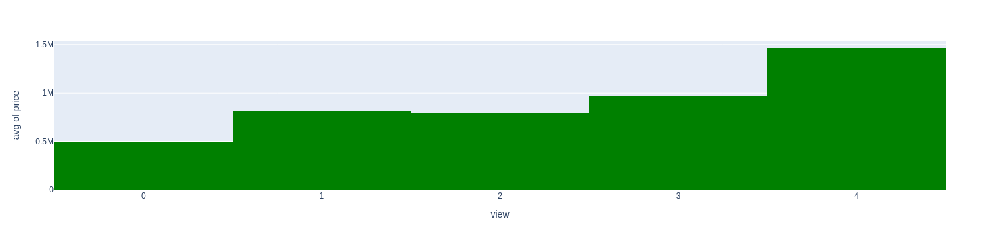

In [15]:
plot_hist(df, "view", log_of_count=True, log_of_price=False)

## Condition

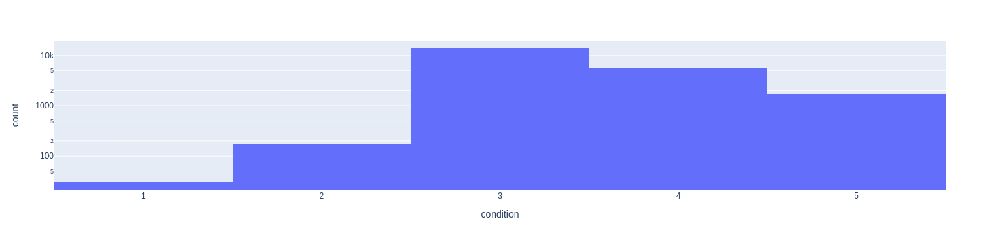

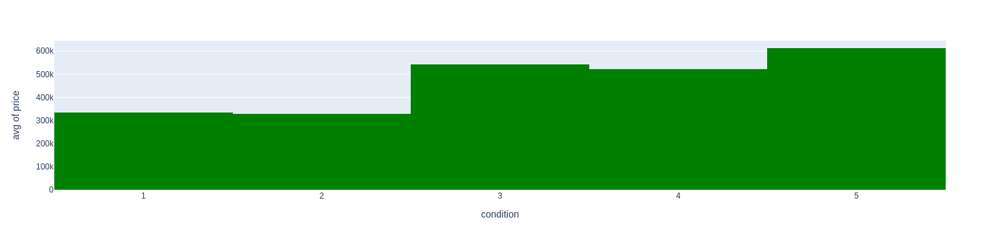

In [16]:
plot_hist(df, "condition", log_of_count=True, log_of_price=False)

## Grade

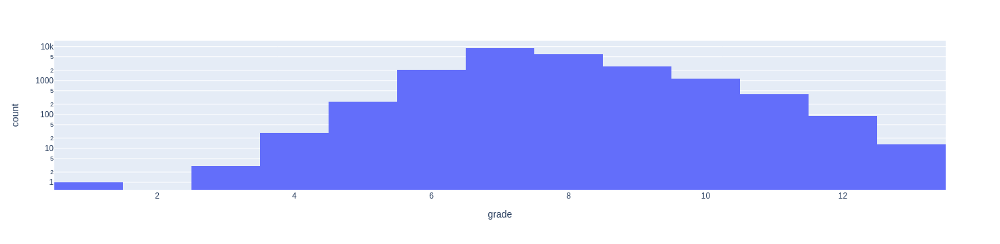

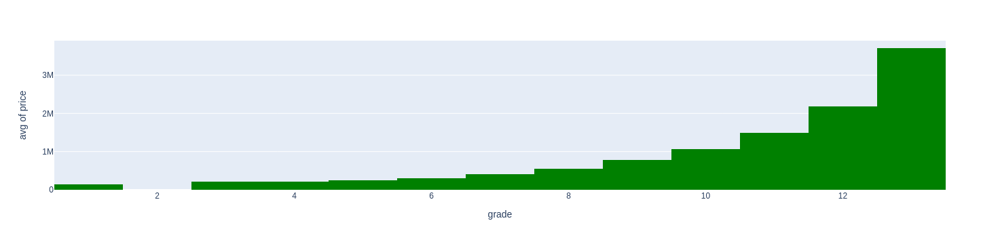

In [17]:
plot_hist(df, "grade", log_of_count=True, log_of_price=False)

## Year built

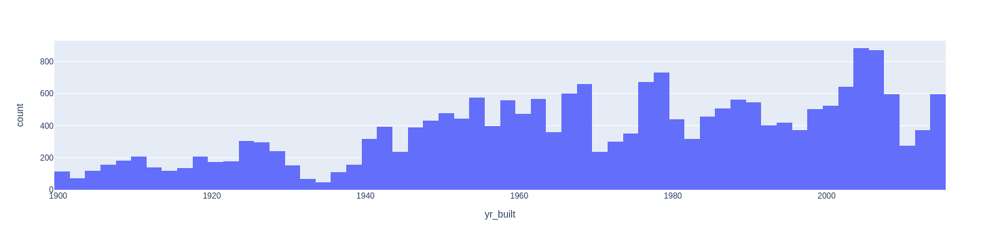

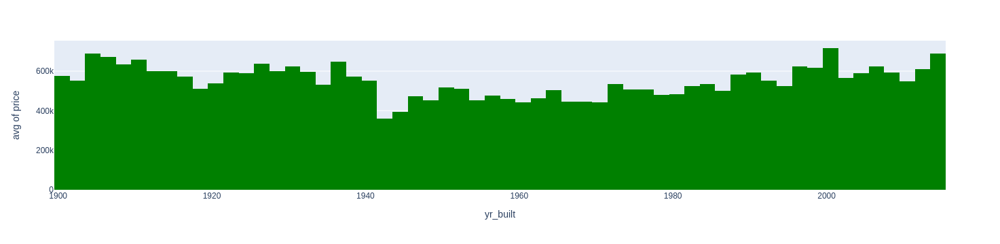

In [18]:
plot_hist(df, "yr_built", log_of_count=False, log_of_price=False)

### Inferring house age
* There are 12 houses that were sold before being built 

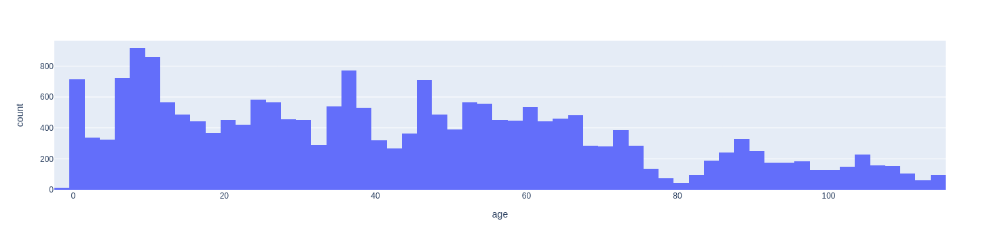

In [19]:
df["age"] = df["date"].map(lambda s: s.year) - df["yr_built"].astype(int)
px.histogram(df, x="age")

## Year renovated
* The `yr_renovated` column can have 0 values if the house was never renovated.

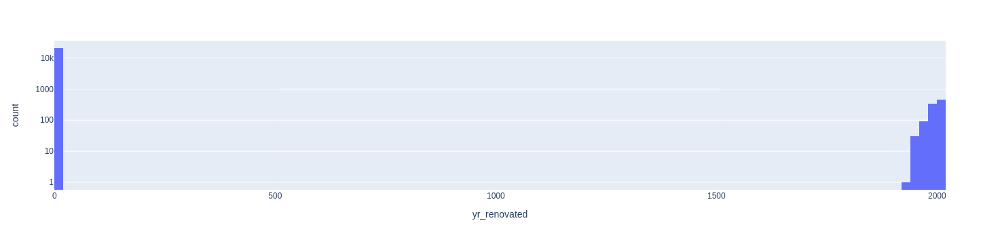

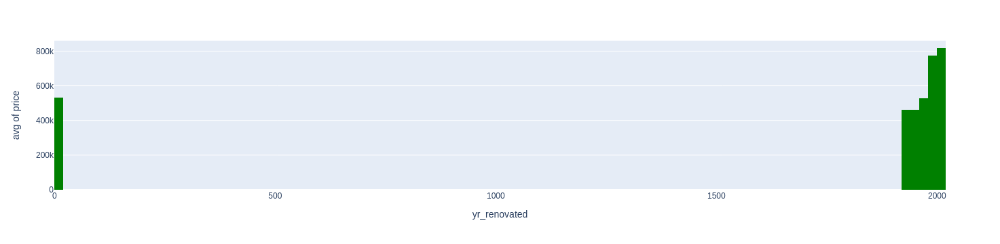

In [20]:
plot_hist(df, "yr_renovated", log_of_count=True, log_of_price=False)

### Filterting by houses that were renovated

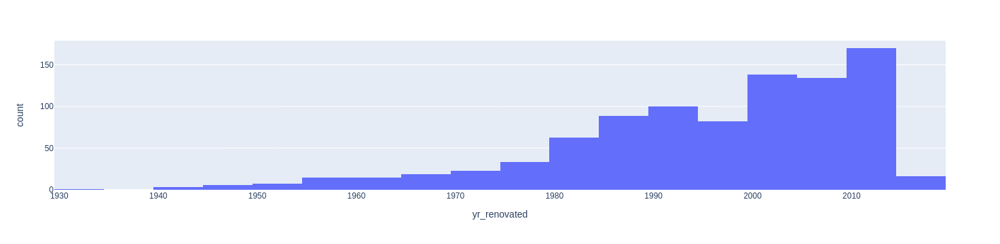

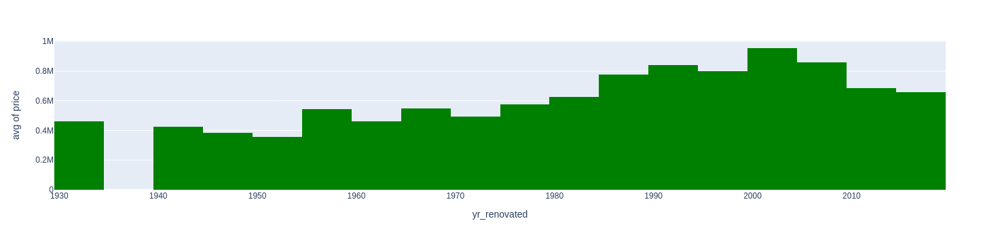

In [21]:
plot_hist(df[df["yr_renovated"] != 0], "yr_renovated", log_of_count=False, log_of_price=False)

## Zipcode
* All zipcodes start with `98`.
* When converting them to string, I sorted the dataframe by the zip code so that we can visualize if close zip codes have price similarities. Which is clear there is some.

In [22]:
len(set(df["zipcode"]))

70

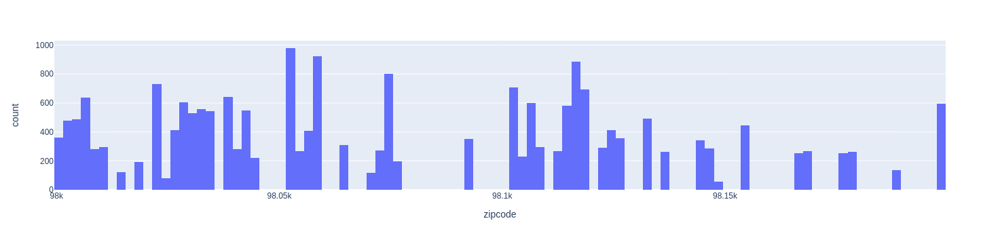

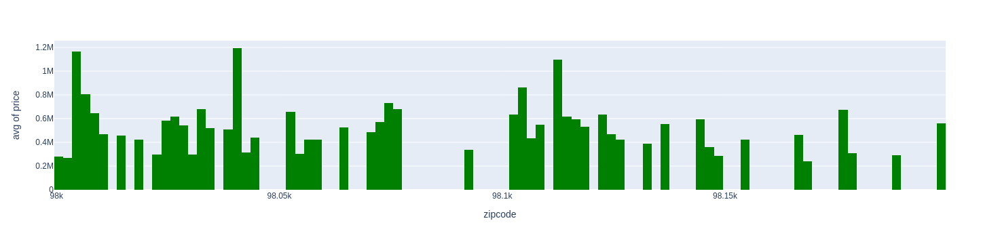

In [23]:
plot_hist(df, "zipcode", log_of_count=False, log_of_price=False)

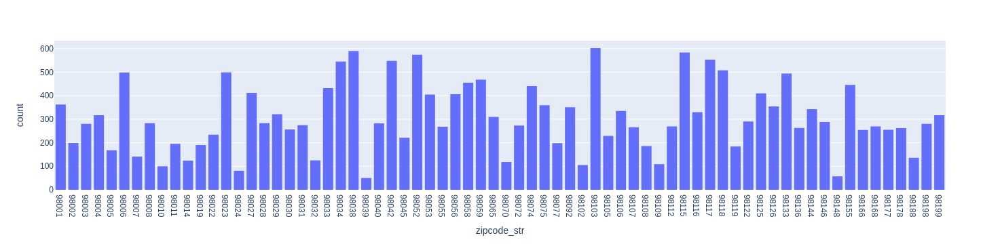

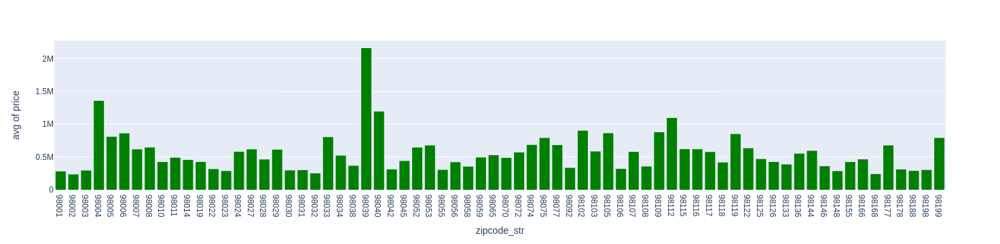

In [24]:
df["zipcode_str"] = df["zipcode"].astype(str)
plot_hist(df.sort_values("zipcode_str"), "zipcode_str", log_of_count=False, log_of_price=False)

## Heatmaps of latitude and longitude

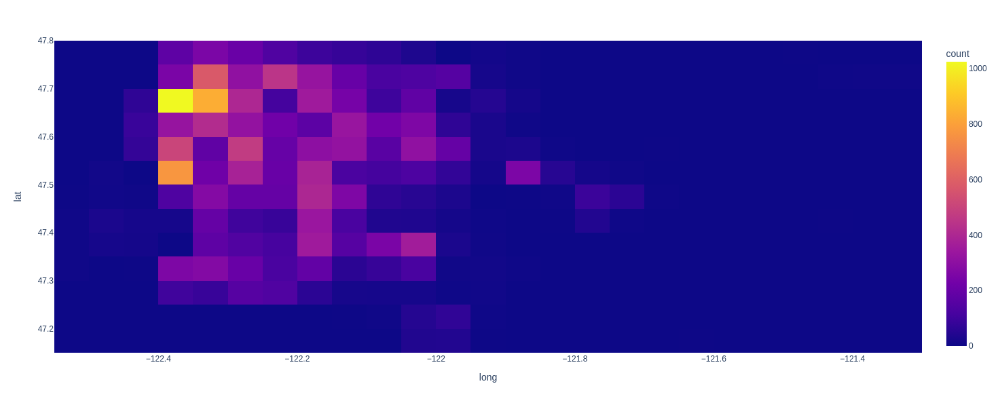

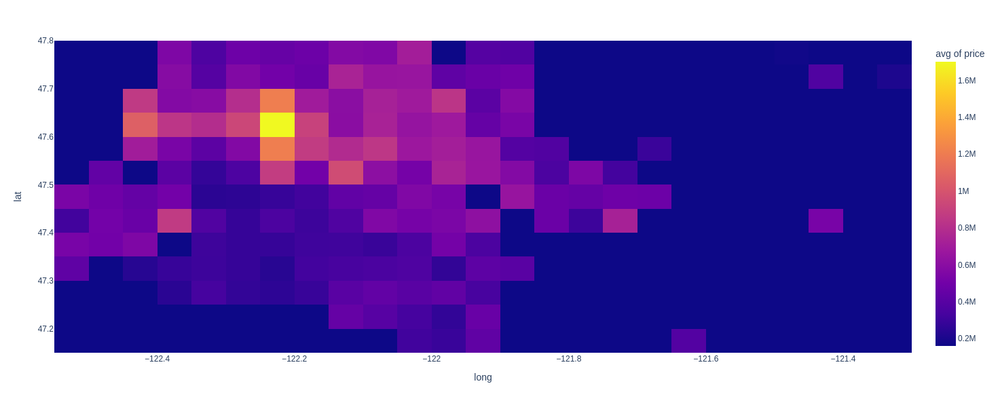

In [25]:
fig = px.density_heatmap(df, x="long", y="lat")
fig.update_layout(
        autosize=False,
        width=700,
        height=600    
    )
fig.show()
fig = px.density_heatmap(df, x="long", y="lat", z="price", histfunc="avg")
fig.update_layout(
        autosize=False,
        width=700,
        height=600    
    )
fig.show()

## Areas
* To visualize the areas of these sparse ranges I will be using scatter plots with non-linear trendlines to visualize correlations
* As expected they are mostly very correlated with price (except for `sqft_lot`)

In [26]:
def plot_scatter(col):
    fig = px.scatter(df, x=col, y="price", log_x=True, log_y=True, trendline="lowess", trendline_color_override="red", trendline_options=dict(frac=0.8), opacity=0.7)
    fig.update_layout(
        autosize=False,
        width=700,
        height=700    
    )
    fig.show()

In [27]:
(df["sqft_lot"] <= df["sqft_living"]).sum()

789

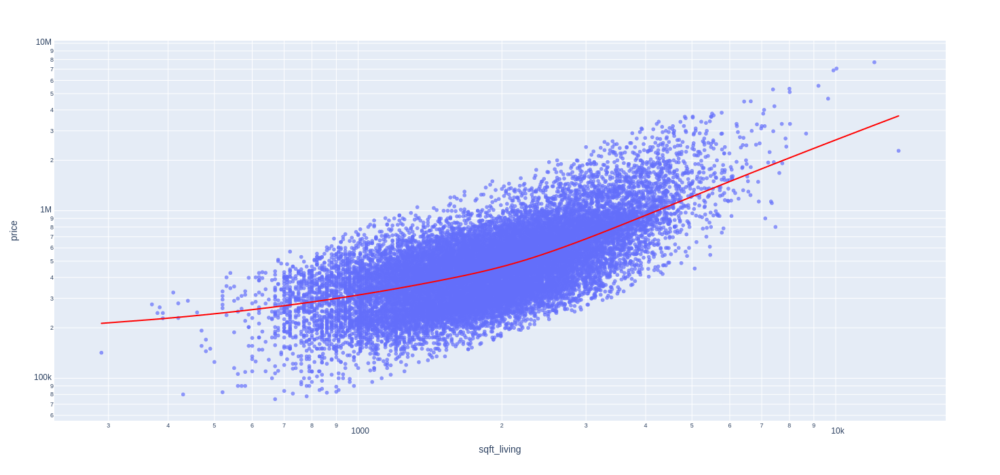

In [28]:
plot_scatter("sqft_living")

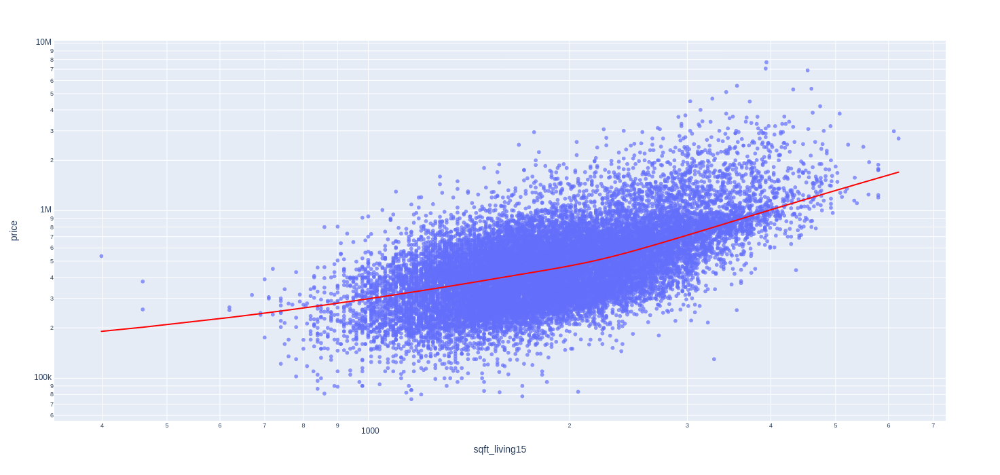

In [29]:
plot_scatter("sqft_living15")

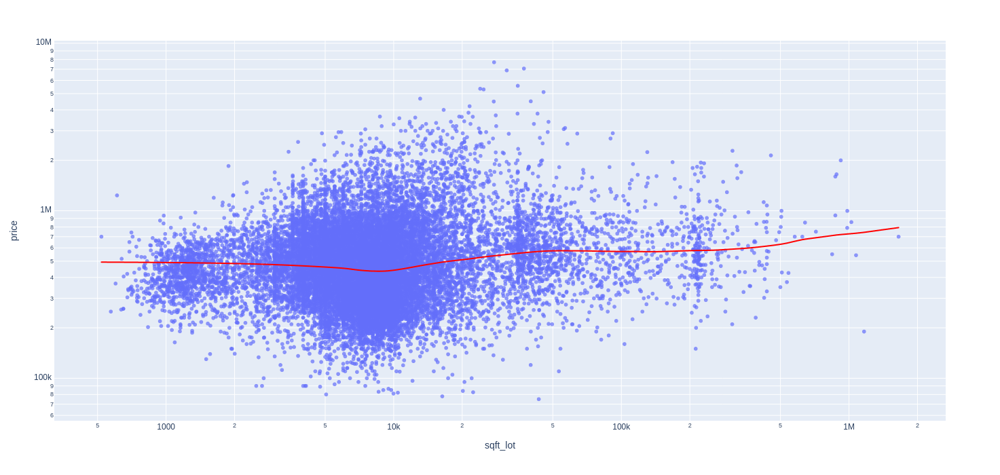

In [30]:
plot_scatter("sqft_lot")

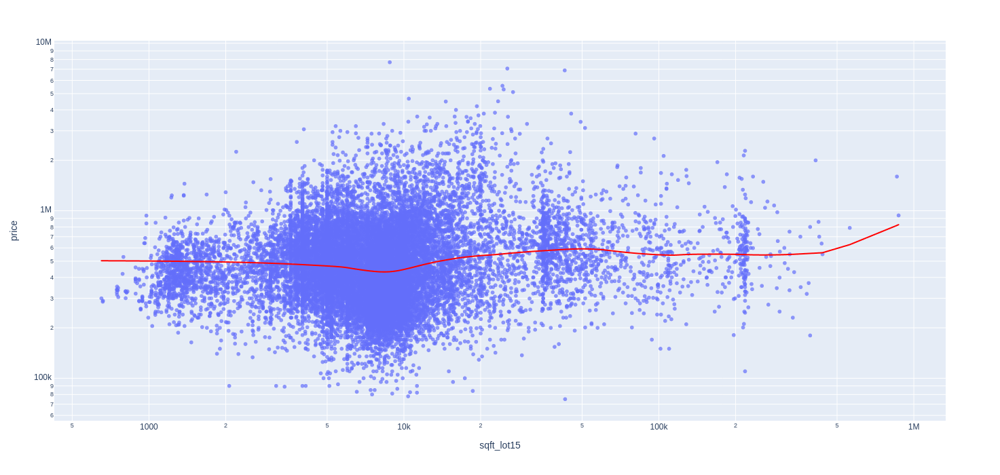

In [31]:
plot_scatter("sqft_lot15")

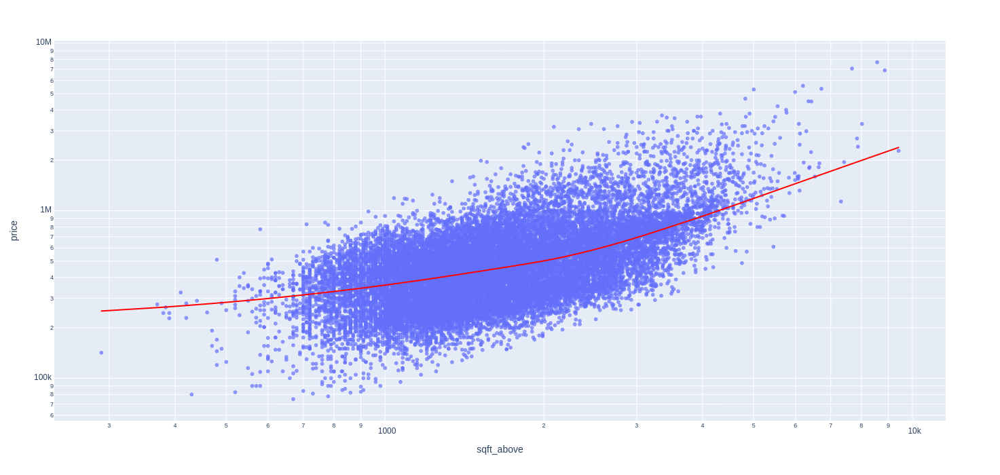

In [32]:
plot_scatter("sqft_above")

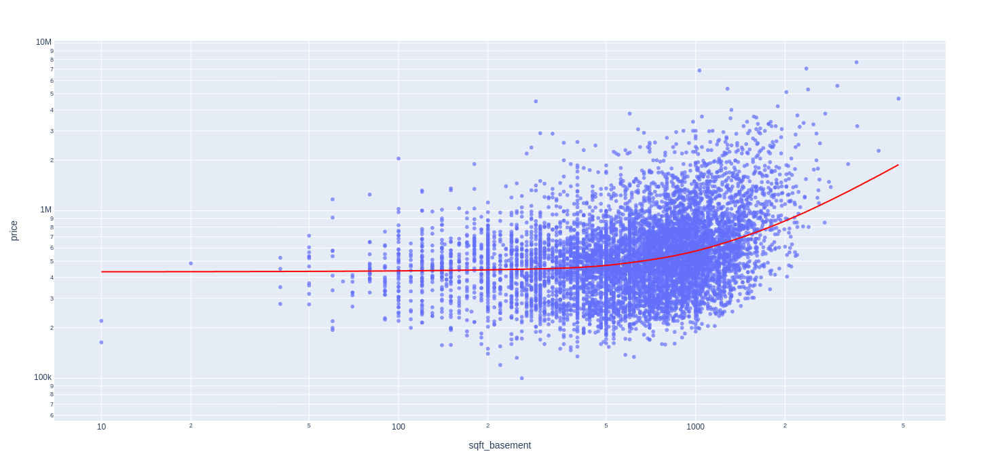

In [33]:
plot_scatter("sqft_basement")